In [1]:
!nvidia-smi

Thu Jan 22 15:40:29 2026       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 572.61                 Driver Version: 572.61         CUDA Version: 12.8     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                  Driver-Model | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA GeForce RTX 4090      WDDM  |   00000000:01:00.0  On |                  Off |
|  0%   38C    P8             16W /  450W |     700MiB /  24564MiB |      3%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [2]:
import torch

print("CUDA available:", torch.cuda.is_available())

if torch.cuda.is_available():
    print("GPU name:", torch.cuda.get_device_name(0))
    device = torch.device("cuda")
else:
    device = torch.device("cpu")

print("Using device:", device)


CUDA available: True
GPU name: NVIDIA GeForce RTX 4090
Using device: cuda


In [3]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="QPnypz6jTqSK3sauF1hK")
project = rf.workspace("md-uzzal-mia").project("blind-assistant-vbhah-03g8u")
version = project.version(1)
dataset = version.download("yolov12")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Blind-Assistant-1 in yolov12:: 100%|██████████| 3670/3670 [00:00<00:00, 5362.92it/s]


In [4]:
!pip install ultralytics

In [5]:
!pip install roboflow


image 1/1 D:\Uzzal_ICE_14_Batch\object\Blind-Assistant-1\train\images\road25_JPG.rf.986051327a6a4bf90cd6b0d29ce7541d.jpg: 640x640 (no detections), 8.7ms
Speed: 2.0ms preprocess, 8.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Results saved to D:\Uzzal_ICE_14_Batch\object\runs\detect\predict


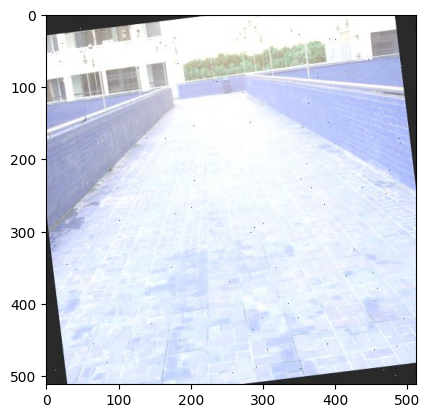

In [6]:
from ultralytics import YOLO
import matplotlib.pyplot as plt
# Load a model
model = YOLO("yolo12n.pt")
result = model("D:\\Uzzal_ICE_14_Batch\\object\\Blind-Assistant-1\\train\\images\\road25_JPG.rf.986051327a6a4bf90cd6b0d29ce7541d.jpg", conf=0.25, save=True)
result[0].show()
plt.imshow(result[0].orig_img)

In [25]:
import os

train_images = len(os.listdir('Blind-Assistant-1/train/images'))
test_images = len(os.listdir('Blind-Assistant-1/test/images'))
valid_images = len(os.listdir('Blind-Assistant-1/valid/images'))

print(f"Training images: {train_images}")
print(f"Test images: {test_images}")
print(f"Validation images: {valid_images}")

Training images: 1689
Test images: 69
Validation images: 71


In [7]:
!pip install ruamel.yaml

In [8]:
from pathlib import Path

import ruamel.yaml

yaml = ruamel.yaml.YAML()
src = Path(r"Blind-Assistant-1/data.yaml")

base = src.parent
with src.open('r') as fp:
    data = yaml.load(fp)

data['train'] = str((base / 'train' / 'images').resolve())
data['test'] = str((base / 'test' / 'images').resolve())
data['val'] = str((base / 'valid' / 'images').resolve())

print(data['train'])
print(data['test'])
print(data['val'])

with open('data.yaml', 'w') as fp:
    yaml.dump(data, fp)

D:\Uzzal_ICE_14_Batch\object\Blind-Assistant-1\train\images
D:\Uzzal_ICE_14_Batch\object\Blind-Assistant-1\test\images
D:\Uzzal_ICE_14_Batch\object\Blind-Assistant-1\valid\images


In [9]:
!pip install yolo

In [10]:
import sys
import ruamel.yaml

# Function to correctly load and save YAML with ruamel.yaml
def update_yaml_file(file_path):
    yaml = ruamel.yaml.YAML()
    with open(file_path) as fp:
        data = yaml.load(fp)

    # Update nc to match the length of names
    if 'names' in data and 'nc' in data and len(data['names']) != data['nc']:
        print(f"Correcting 'nc' from {data['nc']} to {len(data['names'])} in {file_path}")
        data['nc'] = len(data['names'])

    with open(file_path, 'w') as fp:
        yaml.dump(data, fp)

# Call the function to update data.yaml before training
update_yaml_file('data.yaml')


from ultralytics import YOLO

class MyCallback:
    def __init__(self):
        self.best_loss = float('inf')

    def on_train_epoch_end(self, trainer):
        """Called at the end of each training epoch"""
        loss = trainer.loss
        epoch = trainer.epoch
        print(f" Epoch {epoch} completed — Loss: {loss:.4f}")

        # Optional: Save model when loss improves
        if loss < self.best_loss:
            self.best_loss = loss
            trainer.save_model()
            print(f"New best model saved (loss={loss:.4f})")

    def on_fit_end(self, trainer):
        """Called at the end of full training"""
        print("Training completed successfully!")



model = YOLO('yolo12n.pt')

# callback register (new API)
model.add_callback('on_train_epoch_end', MyCallback().on_train_epoch_end)
model.add_callback('on_fit_end', MyCallback().on_fit_end)

# now train normally
results = model.train(
    data="data.yaml",
    epochs=100,
    imgsz=640
)


New https://pypi.org/project/ultralytics/8.4.7 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.240  Python-3.10.19 torch-2.9.1+cu126 CUDA:0 (NVIDIA GeForce RTX 4090, 24564MiB)
engine\trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo12n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optim

In [11]:
model = YOLO('yolo12n.pt')
model = YOLO('runs/detect/train/weights/best.pt')
# Validate the model
metrics = model.val()

Ultralytics 8.3.240  Python-3.10.19 torch-2.9.1+cu126 CUDA:0 (NVIDIA GeForce RTX 4090, 24564MiB)
YOLOv12n summary (fused): 159 layers, 2,558,483 parameters, 0 gradients, 6.3 GFLOPs
val: Fast image access  (ping: 0.00.0 ms, read: 969.2449.5 MB/s, size: 32.5 KB)
val: Scanning D:\Uzzal_ICE_14_Batch\object\Blind-Assistant-1\valid\labels.cache... 71 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 71/71  0.0s
WARNING Box and segment counts should be equal, but got len(segments) = 115, len(boxes) = 126. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 5/5 2.5it/s 2.0s0.2ss
                   all         71        126      0.692      0.554      0.625      0.472
               Vehicle         16         19       0.87      0.421      0.471      0.253
            


image 1/1 d:\Uzzal_ICE_14_Batch\object\Blind-Assistant-1\test\images\man06_JPG.rf.8a5e7fe3bdbd0cafbae9e71757bd1dbb.jpg: 640x640 3 Vehicles, 2 Mans, 18.4ms
Speed: 3.6ms preprocess, 18.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Results saved to D:\Uzzal_ICE_14_Batch\object\runs\detect\predict5


(np.float64(-0.5), np.float64(511.5), np.float64(511.5), np.float64(-0.5))

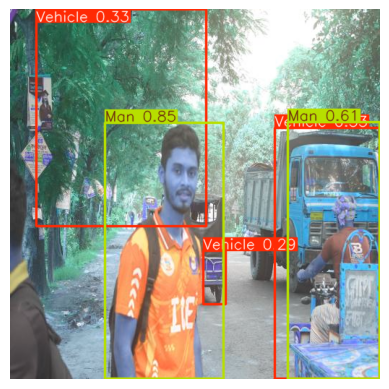

In [15]:
model = YOLO('runs/detect/train/weights/best.pt')

results = model(
    'Blind-Assistant-1/test/images/man06_JPG.rf.8a5e7fe3bdbd0cafbae9e71757bd1dbb.jpg',
    conf=0.25,
    save=True
)

img = results[0].plot()
plt.imshow(img)
plt.axis('off')

(np.float64(-0.5), np.float64(2999.5), np.float64(2249.5), np.float64(-0.5))

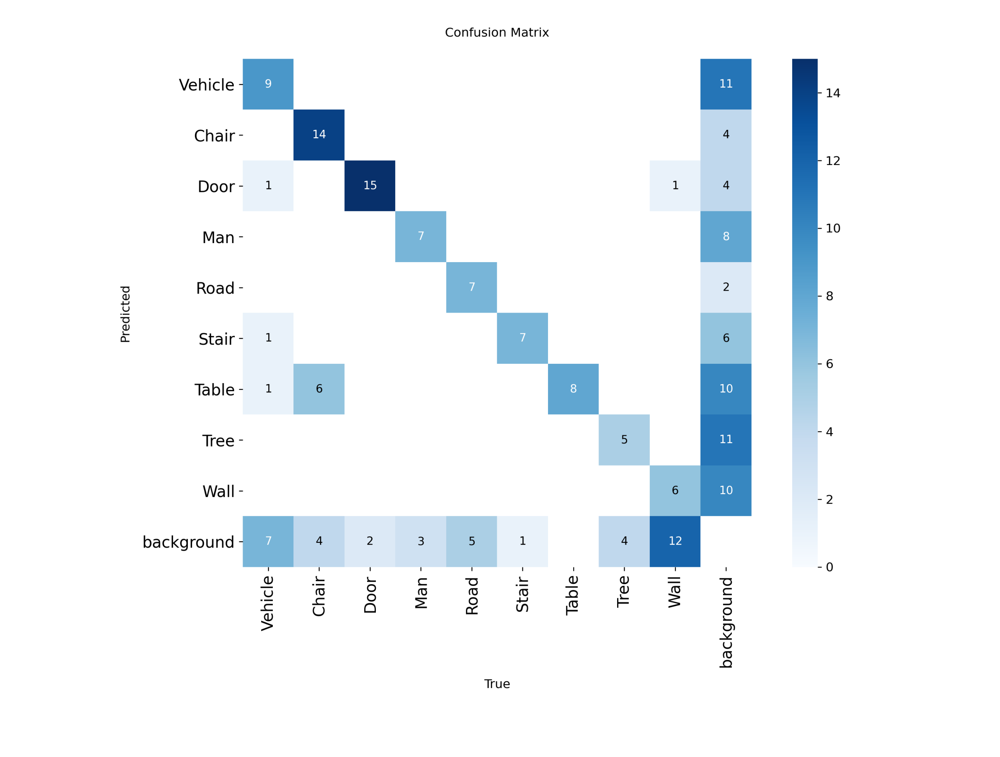

In [17]:
import matplotlib.pyplot as plt
plt.figure(figsize=(12,6), dpi=380)

plt.imshow(plt.imread('runs/detect/train/confusion_matrix.png'))
plt.axis('off')

(np.float64(-0.5), np.float64(2249.5), np.float64(1499.5), np.float64(-0.5))

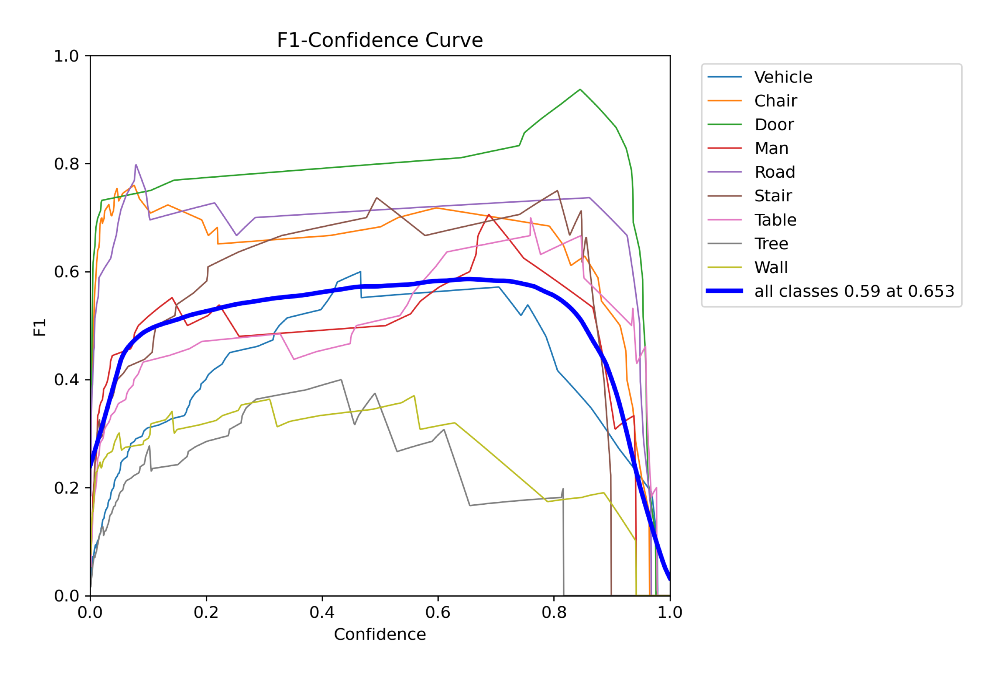

In [18]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10,6), dpi=380)

plt.imshow(plt.imread('runs/detect/train/BoxF1_curve.png'))
plt.axis('off')

(np.float64(-0.5), np.float64(2249.5), np.float64(1499.5), np.float64(-0.5))

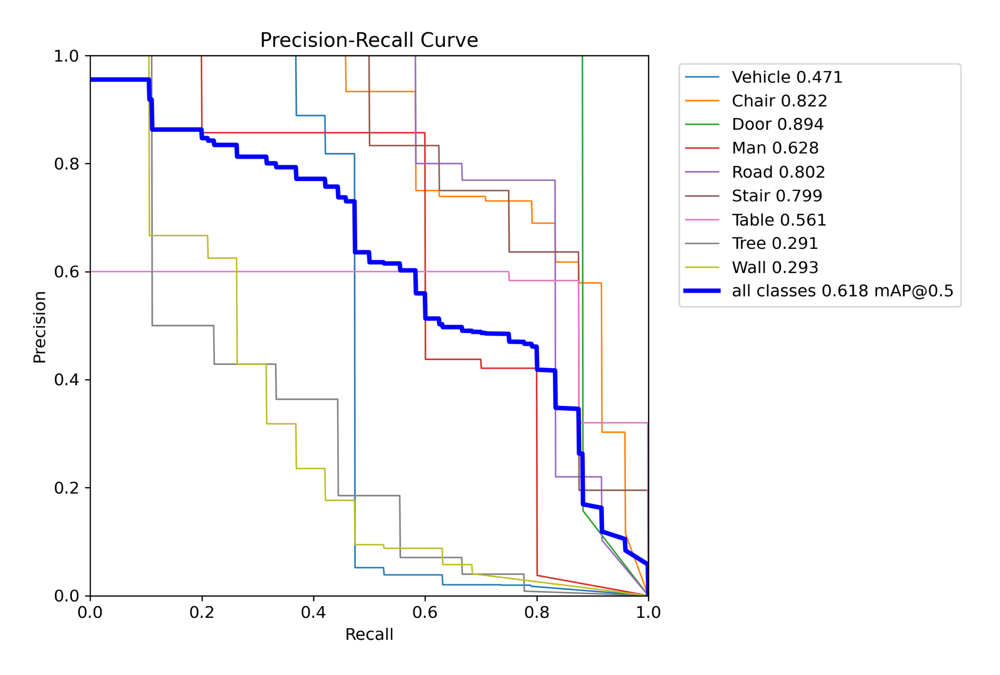

In [19]:
plt.figure(figsize=(10,6), dpi=380)

plt.imshow(plt.imread('runs/detect/train/BoxPR_curve.png'))
plt.axis('off')

(np.float64(-0.5), np.float64(2249.5), np.float64(1499.5), np.float64(-0.5))

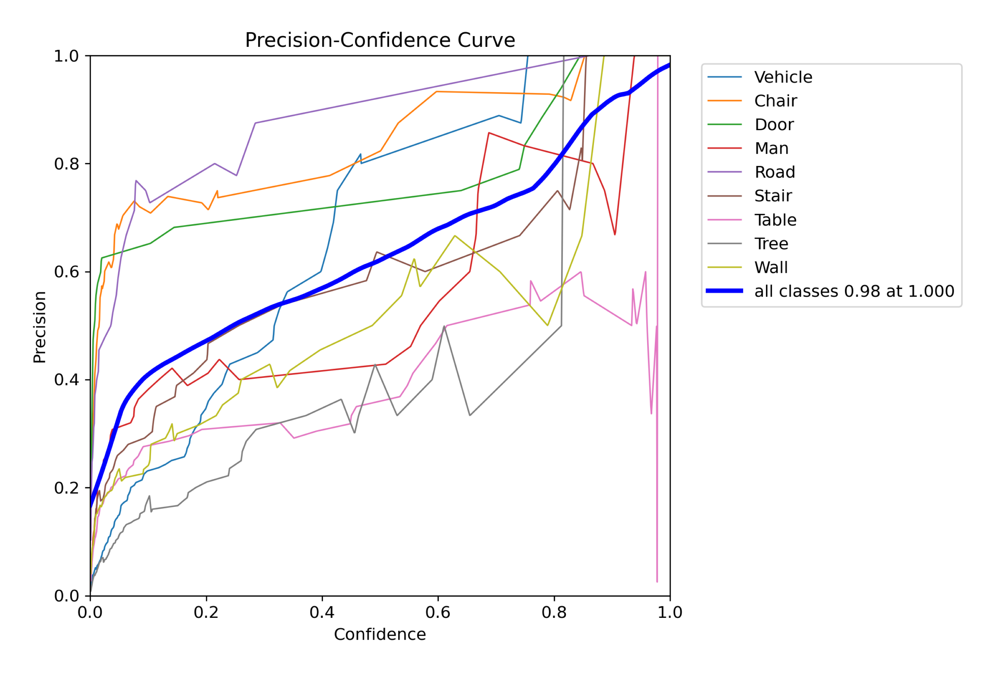

In [20]:
plt.figure(figsize=(10,6), dpi=380)

plt.imshow(plt.imread('runs/detect/train/BoxP_curve.png'))
plt.axis('off')

(np.float64(-0.5), np.float64(2249.5), np.float64(1499.5), np.float64(-0.5))

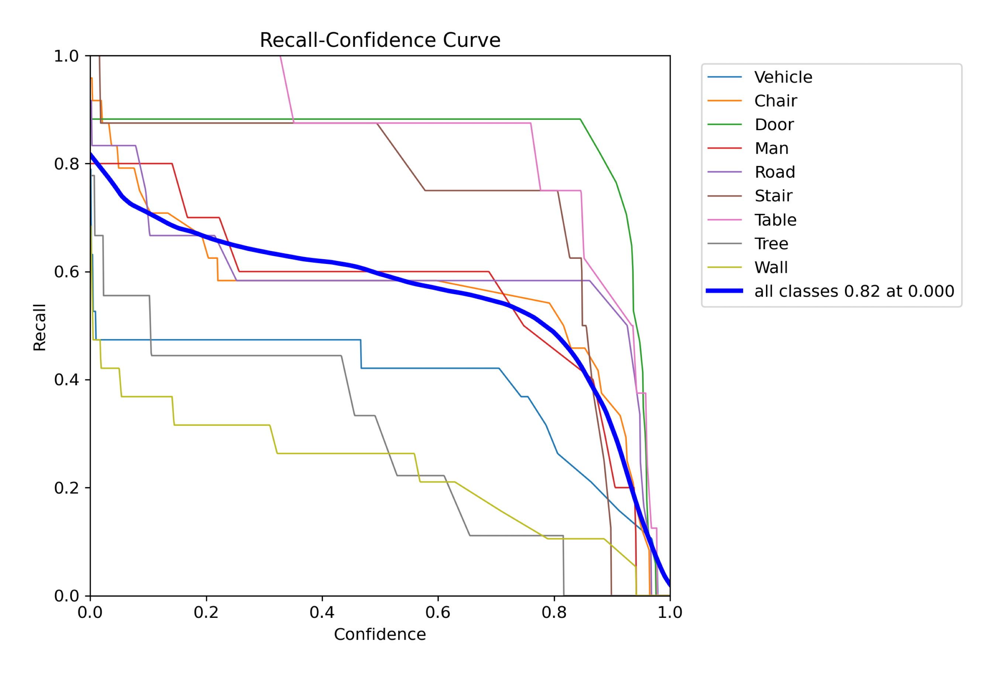

In [21]:
plt.figure(figsize=(10,6), dpi=380)

plt.imshow(plt.imread('runs/detect/train/BoxR_curve.png'))
plt.axis('off')

(np.float64(-0.5), np.float64(2999.5), np.float64(2249.5), np.float64(-0.5))

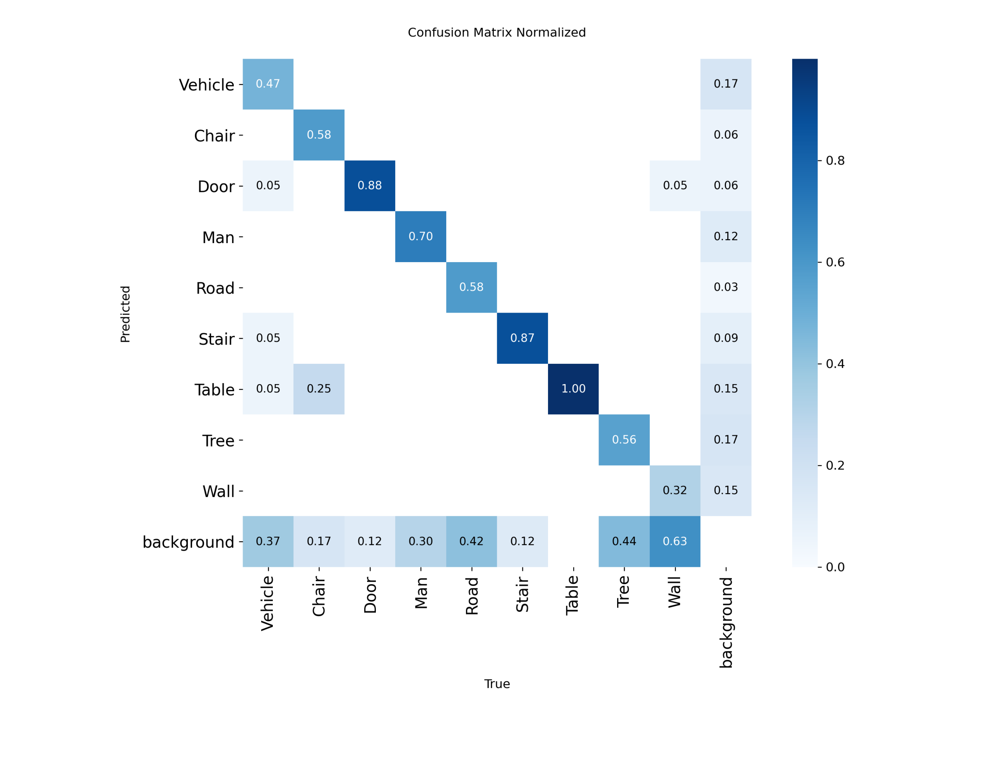

In [22]:
plt.figure(figsize=(10,6), dpi=380)

plt.imshow(plt.imread('runs/detect/train/confusion_matrix_normalized.png'))
plt.axis('off')

(np.float64(-0.5), np.float64(2399.5), np.float64(1199.5), np.float64(-0.5))

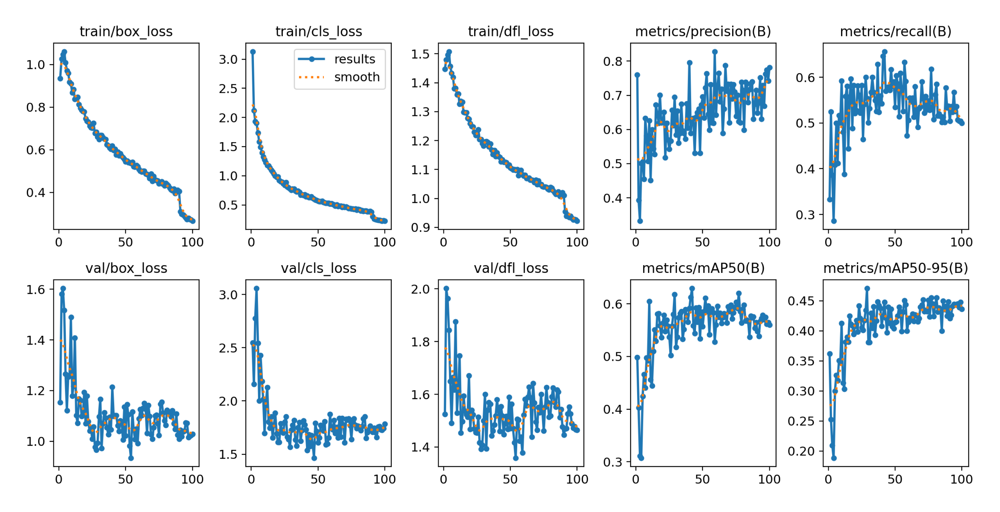

In [23]:
plt.figure(figsize=(10,14 ), dpi=380)

plt.imshow(plt.imread('runs/detect/train/results.png'))
plt.axis('off')

(np.float64(-0.5), np.float64(1599.5), np.float64(1599.5), np.float64(-0.5))

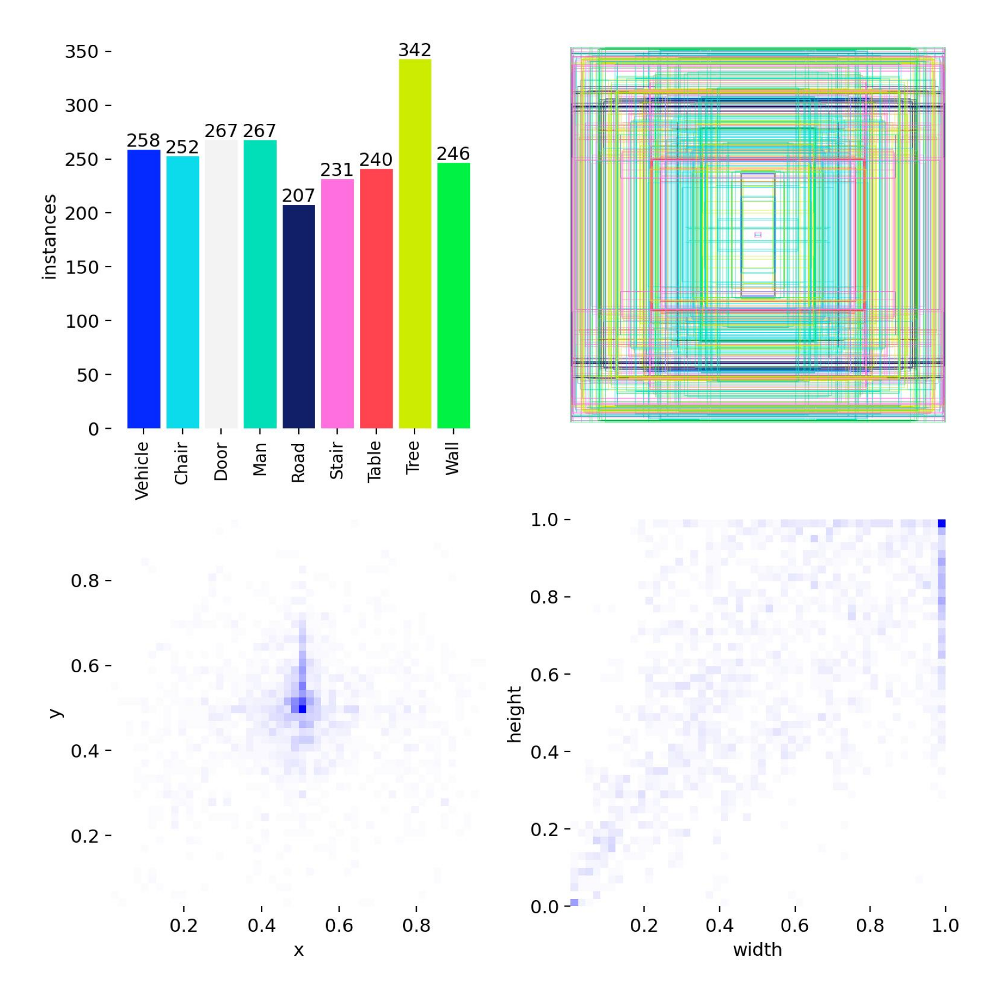

In [24]:
plt.figure(figsize=(10,6), dpi=380)

plt.imshow(plt.imread('runs/detect/train/labels.jpg'))
plt.axis('off')

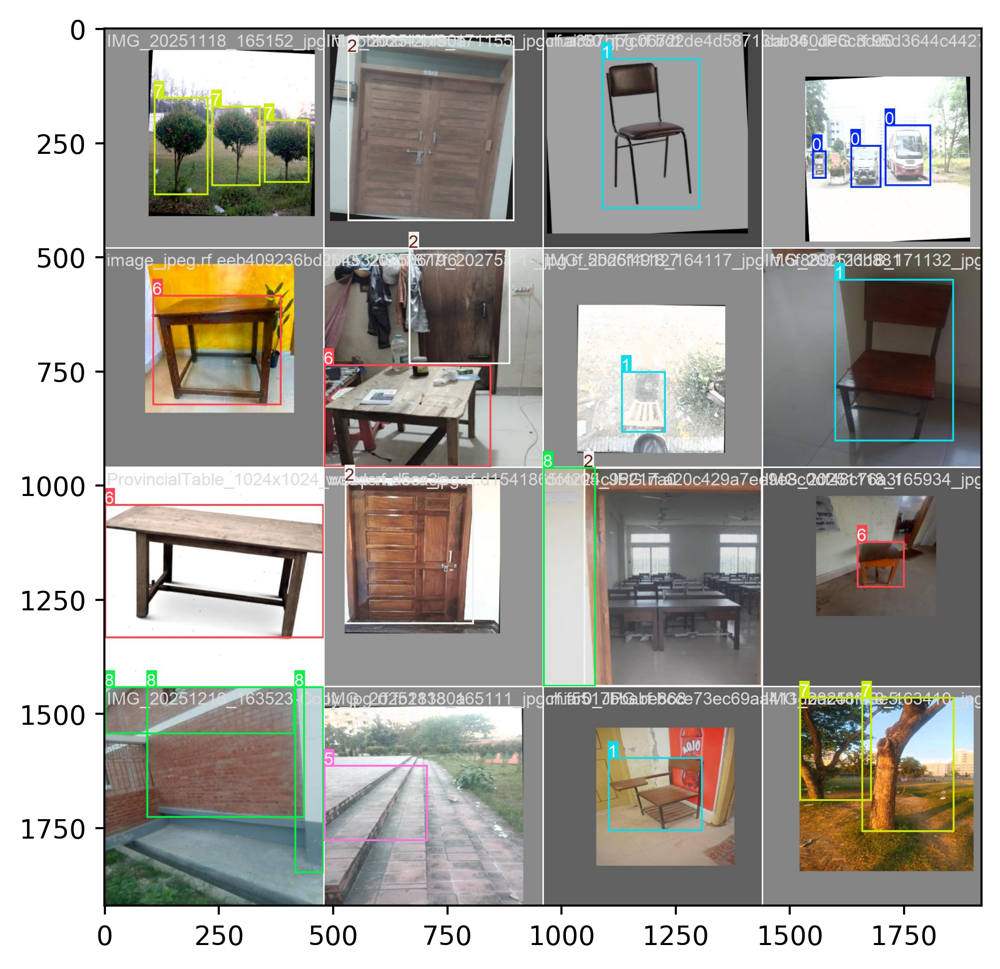

In [26]:
plt.figure(figsize=(10,6), dpi=380)

plt.imshow(plt.imread('runs/detect/train/train_batch9542.jpg'))

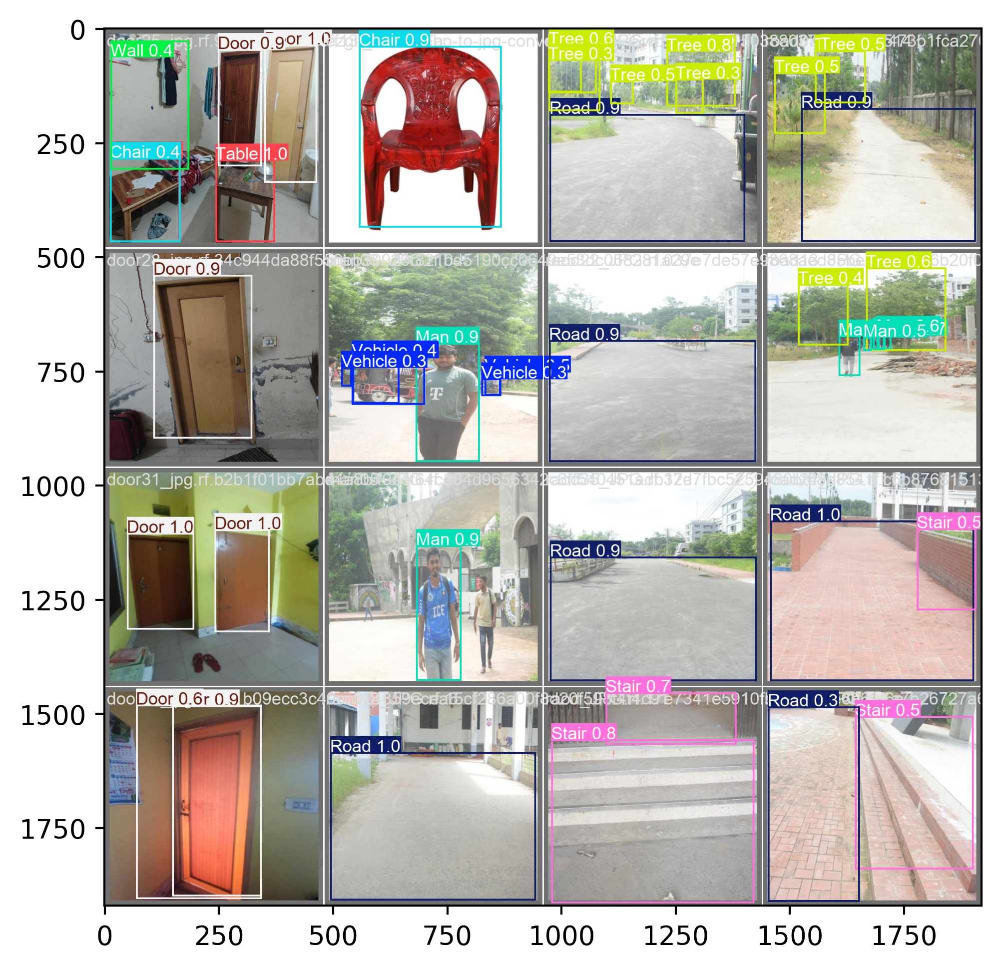

In [28]:
plt.figure(figsize=(10,6), dpi=380)

plt.imshow(plt.imread('runs/detect/train/val_batch1_pred.jpg'))

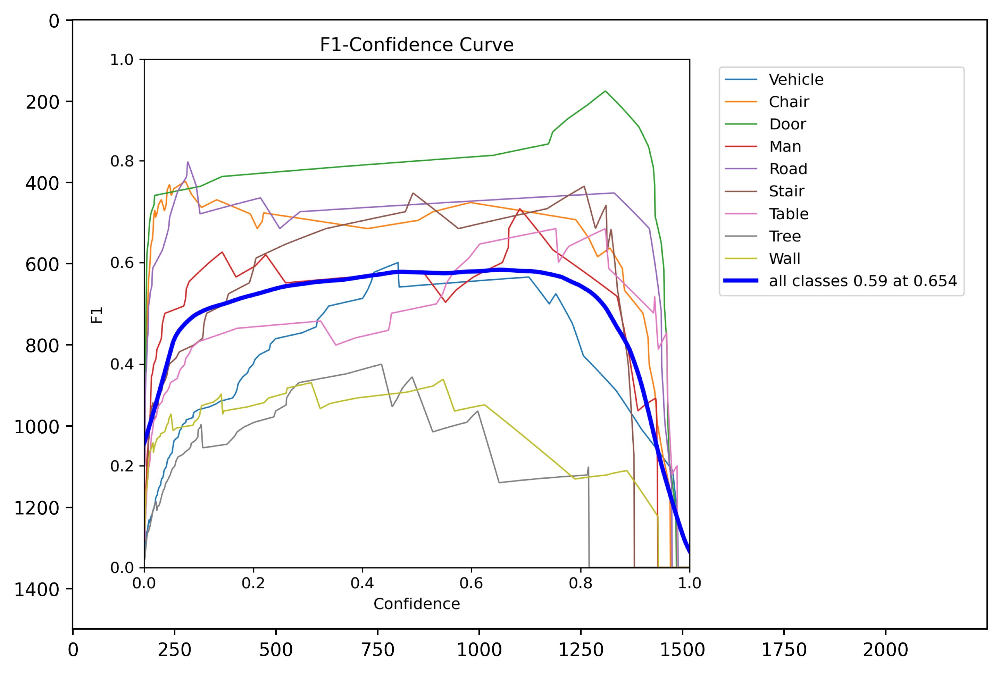

In [29]:
plt.figure(figsize=(10,6), dpi=380)

plt.imshow(plt.imread('runs/detect/val/BoxF1_curve.png'))

In [30]:
model = YOLO('runs/detect/train/weights/best.pt')
result = model('Blind-Assistant-1/test/images', conf=0.25, save=True)
result[0].show()


image 1/69 d:\Uzzal_ICE_14_Batch\object\Blind-Assistant-1\test\images\IMG_20251118_164131_jpg.rf.315b3e30039a779d55bdb8c7966519f7.jpg: 640x640 1 Table, 22.2ms
image 2/69 d:\Uzzal_ICE_14_Batch\object\Blind-Assistant-1\test\images\IMG_20251118_165155_jpg.rf.e0f06c5224a21bfe4e113e0368ade39b.jpg: 640x640 3 Trees, 18.7ms
image 3/69 d:\Uzzal_ICE_14_Batch\object\Blind-Assistant-1\test\images\IMG_20251118_165842_jpg.rf.6e41b46a03ae7d8e43412d9dcb1c63f1.jpg: 640x640 1 Vehicle, 20.0ms
image 4/69 d:\Uzzal_ICE_14_Batch\object\Blind-Assistant-1\test\images\IMG_20251118_171142_jpg.rf.51b0ade00117ace8cf72db2cc3fdfeb4.jpg: 640x640 1 Stair, 17.1ms
image 5/69 d:\Uzzal_ICE_14_Batch\object\Blind-Assistant-1\test\images\IMG_20251118_171319_jpg.rf.eb461fa31d6baa39e50b1905156a33ce.jpg: 640x640 1 Road, 16.1ms
image 6/69 d:\Uzzal_ICE_14_Batch\object\Blind-Assistant-1\test\images\IMG_20251216_160937_jpg.rf.7af97462d1458accf2ef80038f95bc11.jpg: 640x640 1 Road, 14.3ms
image 7/69 d:\Uzzal_ICE_14_Batch\object\Blind

In [31]:
import glob
import matplotlib.pyplot as plt

def read_images_from_folder(folder, img_ext):
  images = []

  # Corrected: Call glob.glob directly
  for filename in glob.glob(f"{folder}/*.{img_ext}"):
    img = plt.imread(filename)
    if img is not None:
      images.append(img)
  return images

def sample_images9(images):
  sample = []
  for i in range(25):
    # Corrected a typo in append
    sample.append(images[i])
  return sample

def show_images(images):
  fig = plt.figure(figsize=(10,10), dpi= 380)
  columns = 5
  rows = 5
  for i in range(1, columns*rows + 1):
    # Corrected index: Use i-1 to access list elements starting from 0
    img = images[i-1]
    fig.add_subplot(rows, columns, i)
    plt.imshow(img) # Pass the image to imshow
    plt.axis('off')
  plt.show()

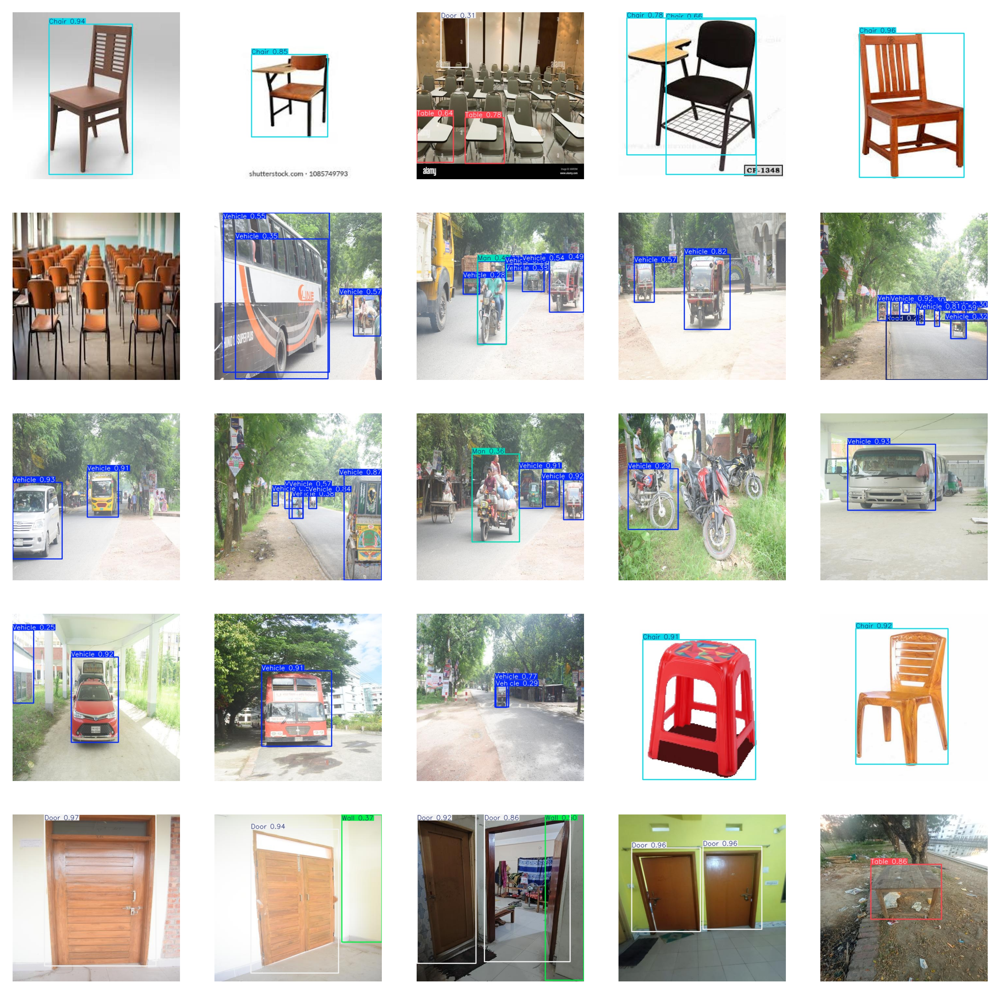

In [32]:
images_val = read_images_from_folder('runs/detect/predict6','jpg')
sample_images = sample_images9(images_val)
show_images(sample_images)